In [1]:
import matplotlib.pyplot as plt
import numpy as np
import os
import pathlib
import PIL


import tensorflow as tf
from tensorflow import  keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [2]:
data_dir=pathlib.Path('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/')

In [4]:
img_count=len(list(data_dir.glob('*/*')))
print(img_count)

407


In [5]:
healthy=list(data_dir.glob('Healthy/*'))
healthy

[WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(1).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(10).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(100).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(101).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(102).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(11).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(12).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/Master Python/DL Project/Wheat/archive/wheat_leaf/Healthy/loh(13).JPG'),
 WindowsPath('C:/Users/viral/OneDrive/Desktop/

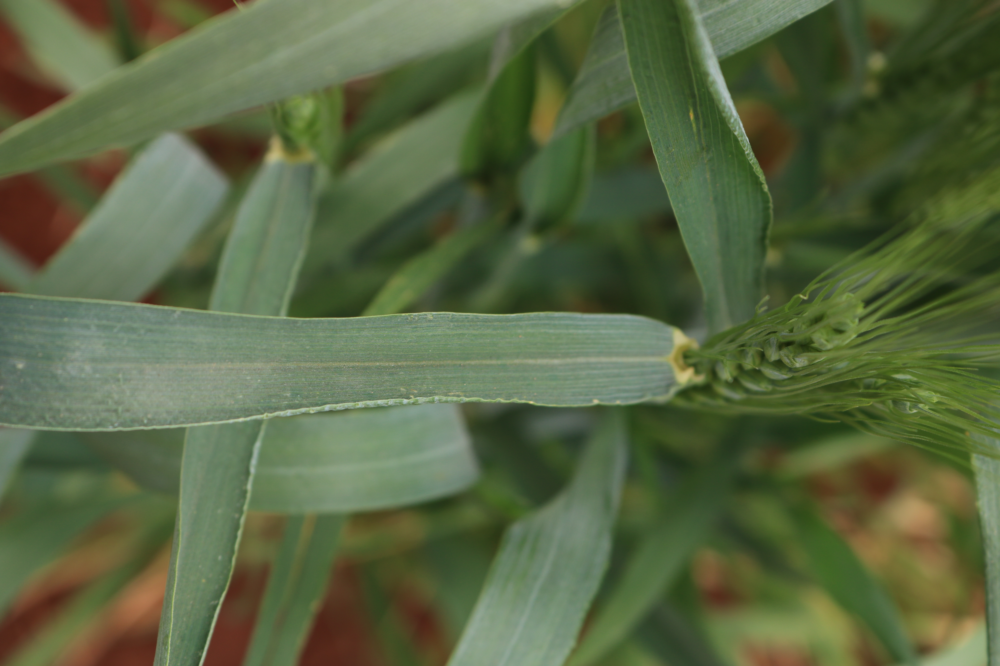

In [7]:
PIL.Image.open(str(healthy[1]))

In [8]:
batch_size=32
img_height=180
img_width=180

In [10]:
train_ds=keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset='training',
    seed=123,
    image_size=(img_height,img_width),
    batch_size=batch_size

)

Found 407 files belonging to 3 classes.
Using 326 files for training.


In [11]:
val_ds=keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset='validation',
    seed=123,
    image_size=(img_height,img_width),
    batch_size=batch_size
)

Found 407 files belonging to 3 classes.
Using 81 files for validation.


In [12]:
class_names=train_ds.class_names

In [13]:
class_names

['Healthy', 'septoria', 'stripe_rust']

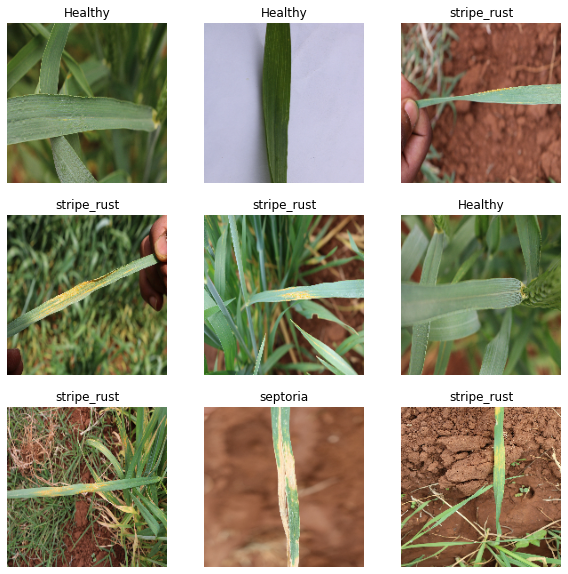

In [14]:
plt.figure(figsize=(10,10))
for image,lable in train_ds.take(1):
    for i in range(9):
        ax=plt.subplot(3,3,i+1)
        plt.imshow(image[i].numpy().astype('uint8'))
        plt.title(class_names[lable[i]])
        plt.axis('off')

In [17]:
model=Sequential([
    layers.Rescaling(1./255,input_shape=(img_height,img_width,3)),
    layers.Conv2D(16,3,padding='same',activation='relu'),
    layers.MaxPooling2D(),
    layers.Conv2D(32,3,padding='same',activation='relu'),
    layers.MaxPooling2D(),
    layers.Conv2D(64,3,padding='same',activation='relu'),
    layers.MaxPooling2D(),
    layers.Flatten(),
    layers.Dense(128,activation='relu'),
    layers.Dense(len(class_names))
    
])


In [19]:
model.compile(optimizer='adam',
             loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
             metrics=['accuracy'])

In [20]:
epoches=10
history=model.fit(train_ds,validation_data=val_ds,epochs=epoches)

Epoch 1/10
11/11 [==============================] - 66s 3s/step - loss: 1.1823 - accuracy: 0.3773 - val_loss: 1.0487 - val_accuracy: 0.5185
Epoch 2/10
11/11 [==============================] - 69s 3s/step - loss: 1.0326 - accuracy: 0.4969 - val_loss: 1.0063 - val_accuracy: 0.6049
Epoch 3/10
11/11 [==============================] - 50s 2s/step - loss: 0.9029 - accuracy: 0.6196 - val_loss: 0.7897 - val_accuracy: 0.6296
Epoch 4/10
11/11 [==============================] - 50s 2s/step - loss: 0.6106 - accuracy: 0.7669 - val_loss: 0.5988 - val_accuracy: 0.6790
Epoch 5/10
11/11 [==============================] - 51s 2s/step - loss: 0.5062 - accuracy: 0.7914 - val_loss: 0.5650 - val_accuracy: 0.6914
Epoch 6/10
11/11 [==============================] - 50s 2s/step - loss: 0.3420 - accuracy: 0.8773 - val_loss: 0.4766 - val_accuracy: 0.8272
Epoch 7/10
11/11 [==============================] - 51s 2s/step - loss: 0.2217 - accuracy: 0.9356 - val_loss: 0.6114 - val_accuracy: 0.7654
Epoch 8/10
11/11 [==

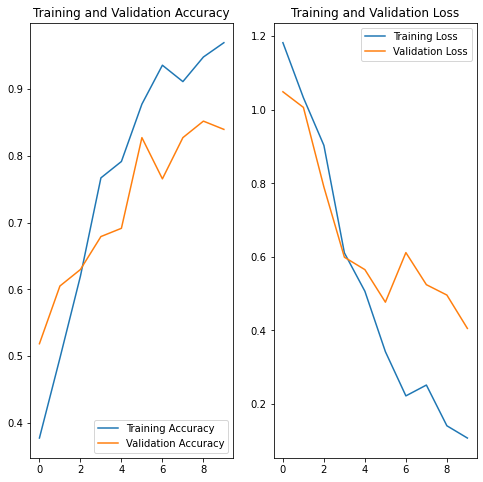

In [22]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epoches)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

### data Augmentation

In [24]:
model=Sequential([
    layers.Rescaling(1./255,input_shape=(img_height,img_width,3)),
    layers.RandomFlip('horizontal',input_shape=(img_height,img_width,3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
    layers.Conv2D(16,3,padding='same',activation='relu'),
    layers.MaxPooling2D(),
    layers.Conv2D(32,3,padding='same',activation='relu'),
    layers.MaxPooling2D(),
    layers.Conv2D(64,3,padding='same',activation='relu'),
    layers.MaxPooling2D(),
    layers.Dropout(0.2),
    layers.Flatten(),
    layers.Dense(128,activation='relu'),
    layers.Dense(len(class_names))
    
])

In [27]:
model.compile(optimizer='adam',loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),metrics=['accuracy'])

In [29]:
epochs=20
history=model.fit(train_ds,validation_data=val_ds,epochs=epochs)

Epoch 1/20
11/11 [==============================] - 278s 13s/step - loss: 0.2919 - accuracy: 0.8957 - val_loss: 0.3450 - val_accuracy: 0.8395
Epoch 2/20
11/11 [==============================] - 402s 17s/step - loss: 0.3407 - accuracy: 0.8742 - val_loss: 0.3453 - val_accuracy: 0.8519
Epoch 3/20
11/11 [==============================] - 311s 10s/step - loss: 0.2661 - accuracy: 0.9080 - val_loss: 0.3491 - val_accuracy: 0.8272
Epoch 4/20
11/11 [==============================] - 275s 11s/step - loss: 0.2430 - accuracy: 0.9018 - val_loss: 0.2755 - val_accuracy: 0.8889
Epoch 5/20
11/11 [==============================] - 202s 5s/step - loss: 0.1906 - accuracy: 0.9325 - val_loss: 0.2228 - val_accuracy: 0.9259
Epoch 6/20
11/11 [==============================] - 224s 9s/step - loss: 0.1988 - accuracy: 0.9264 - val_loss: 0.2388 - val_accuracy: 0.9259
Epoch 7/20
11/11 [==============================] - 227s 9s/step - loss: 0.1583 - accuracy: 0.9479 - val_loss: 0.3186 - val_accuracy: 0.8642
Epoch 8/2

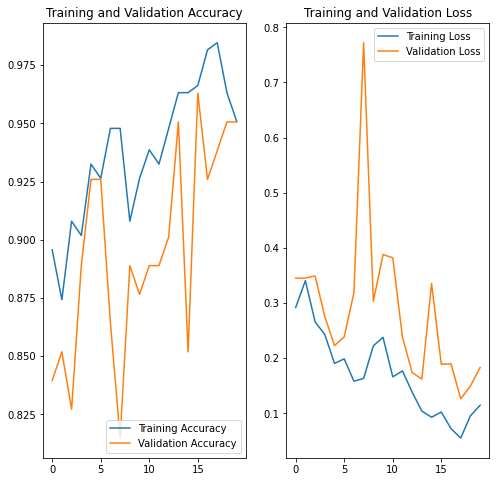

In [30]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [40]:
model.save('history.h5')

In [42]:
x=tf.keras.models.load_model('history.h5')

In [49]:
y='C:/Users/viral/OneDrive/Desktop/Wheat1.jpg'
y2='C:/Users/viral/OneDrive/Desktop/Wheat2.jpg'
y3='C:/Users/viral/OneDrive/Desktop/Wheat3.jpg'

In [53]:
img = tf.keras.utils.load_img(
    y3, target_size=(img_height, img_width)
)
img_array = tf.keras.utils.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch

predictions = model.predict(img_array)
score = tf .nn.softmax(predictions[0])

In [54]:
score

<tf.Tensor: shape=(3,), dtype=float32, numpy=array([9.8606199e-01, 4.5112682e-08, 1.3937985e-02], dtype=float32)>

In [55]:
print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score))
)

This image most likely belongs to Healthy with a 98.61 percent confidence.
